# INM433 - Individual coursework: Visual analytics

## Packages

In [1]:
from functions import *

alt.renderers.enable('notebook');
sns.set( style = "whitegrid" );

C:\ProgramData\Anaconda3\lib\site-packages\pysal\explore\segregation\network\network.py:16: UserWarning: You need pandana and urbanaccess to work with segregation's network module
You can install them with  `pip install urbanaccess pandana` or `conda install -c udst pandana urbanaccess`
  "You need pandana and urbanaccess to work with segregation's network module\n"
C:\ProgramData\Anaconda3\lib\site-packages\pysal\model\spvcm\abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


## Load data

In [2]:
path = "C:\\Users\\Asus\\Documents\\City University\\INM433 Visual Analytics\\IndivualCoursework\\data\\coursework\\"

In [3]:
schools = pd.read_csv(path + "Modified\\Schools.csv", index_col =0)
boro_precinct_arrest = pd.read_csv(path + "Modified\\boro_precinct_arrest.csv", index_col =0)
boro_PI = pd.read_csv(path + "Modified\\boro_PI.csv", index_col =0)

In [4]:
districts = gp.read_file(path + "Modified\\Districts.shp")
districts_table = pd.read_csv(path + "Modified\\Districts_table.csv")
districts = pd.concat([districts.set_index(["Borough","boro_cd"]),districts_table.set_index(["Borough","boro_cd"])], axis =1)
districts.reset_index(inplace = True)

## First insights

- Data type

In [5]:
schools.shape

(1707, 21)

In [6]:
boro_precinct_arrest.shape

(167286, 26)

In [7]:
schools.dtypes.value_counts()

object     13
int64       5
float64     3
dtype: int64

- Aggregation

boro_cd, boro_name, latitude, longitude, geometry

- Zone and time covered

In [8]:
print( boro_precinct_arrest["ARREST_DATE"].min( ) )
print( boro_precinct_arrest["ARREST_DATE"].max( ) )

2019-01-01
2019-09-30


In [9]:
boro_precinct_arrest.groupby(["boro_name","boro_cd"]).size().reset_index().shape

(59, 3)

> 2 figures : Quality of data

erroneous values, missing values, outliers, peculiar distributions, gaps or non-uniformity in spatial and/or temporal coverage, noisiness, and biase


- Missing boroughs in the population file or wrong cd code

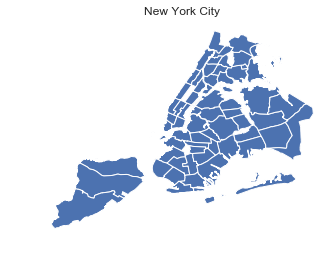

In [10]:
districts.plot()
plt.axis("off")
plt.title("New York City");

- Quality of precinct arrest

In [11]:
missing = boro_precinct_arrest.isna().sum()/boro_precinct_arrest.shape[0]*100

In [12]:
missing[missing>0].index

Index(['PD_CD', 'PD_DESC', 'KY_CD', 'OFNS_DESC', 'LAW_CAT_CD'], dtype='object')

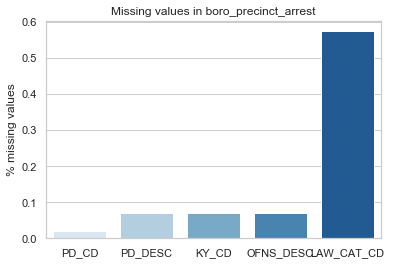

In [13]:
sns.barplot( x = missing[missing>0].index , y = missing[missing>0], palette ="Blues")
plt.title("Missing values in boro_precinct_arrest")
plt.ylabel("% missing values");

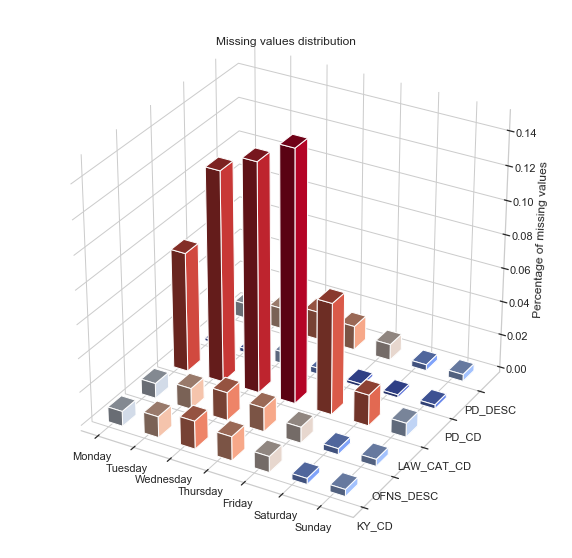

In [14]:
plt.figure(figsize =(10,10))
ax = plt.axes(projection='3d')
test = pd.DataFrame()
cmap = plt.cm.coolwarm
for col in missing[missing>0].index:
    na = boro_precinct_arrest[boro_precinct_arrest[col].isna()]
    test[col]=na["WEEKDAY"].value_counts().apply(lambda x: x/boro_precinct_arrest[boro_precinct_arrest.isna()].shape[0]*100)
test = test.stack().reset_index()
ax.bar3d(test.level_0.replace({"Monday":0,"Tuesday":1,"Wednesday":2,"Thursday":3,"Friday":4,"Saturday":5,"Sunday":6}).astype("int"),
         test.level_1.replace({"KY_CD":0,"OFNS_DESC":1,"LAW_CAT_CD":2,"PD_CD":3,"PD_DESC":4}).astype("int"),
         0,0.4,0.4,
         test[0],
         color = list(map(cmap,test[0].rank()/test.shape[0])))


ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))



plt.xticks([0,1,2,3,4,5,6], labels = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"])
plt.yticks([0,1,2,3,4], labels = ["KY_CD","OFNS_DESC","LAW_CAT_CD","PD_CD","PD_DESC"])
ax.set_zlabel("Percentage of missing values")
plt.title("Missing values distribution");

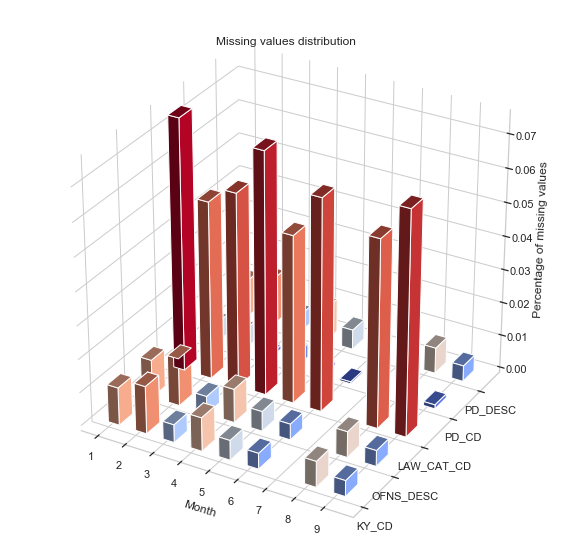

In [15]:
plt.figure(figsize =(10,10))
ax = plt.axes(projection='3d')
test = pd.DataFrame()
cmap = plt.cm.coolwarm
for col in missing[missing>0].index:
    na = boro_precinct_arrest[boro_precinct_arrest[col].isna()]
    test[col]=na["MONTH"].value_counts().apply(lambda x: x/boro_precinct_arrest[boro_precinct_arrest.isna()].shape[0]*100)
test = test.stack().reset_index()
ax.bar3d(test.level_0.astype("int"),
         test.level_1.replace({"KY_CD":0,"OFNS_DESC":1,"LAW_CAT_CD":2,"PD_CD":3,"PD_DESC":4}).astype("int"),
         0,0.4,0.4,
         test[0],
         color = list(map(cmap,test[0].rank()/test.shape[0])))

ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))


plt.xlabel("Month")
plt.yticks([0,1,2,3,4], labels = ["KY_CD","OFNS_DESC","LAW_CAT_CD","PD_CD","PD_DESC"])
plt.xticks([1,2,3,4,5,6,7,8,9], labels = [1,2,3,4,5,6,7,8,9])
ax.set_zlabel("Percentage of missing values")
plt.title("Missing values distribution");

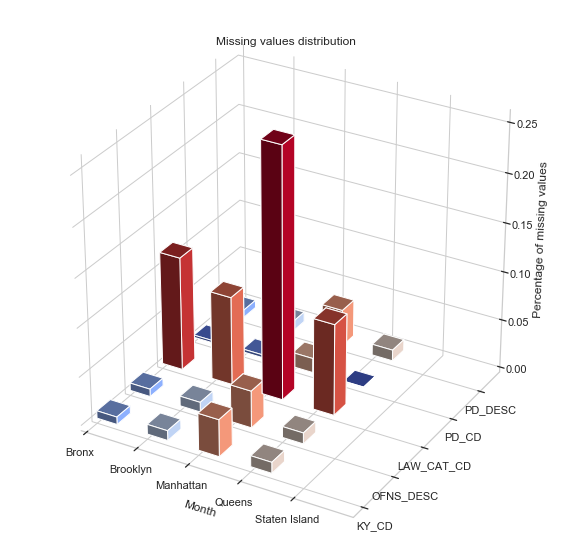

In [16]:
plt.figure(figsize =(10,10))
ax = plt.axes(projection='3d')
test = pd.DataFrame()
cmap = plt.cm.coolwarm
for col in missing[missing>0].index:
    na = boro_precinct_arrest[boro_precinct_arrest[col].isna()]
    test[col]=na["boro_name"].value_counts().apply(lambda x: x/boro_precinct_arrest[boro_precinct_arrest.isna()].shape[0]*100)
test = test.stack().reset_index()
ax.bar3d(test.level_0.replace({"Bronx":0,"Brooklyn":1,"Manhattan":2,"Queens":3,"Staten Island":4}).astype("int"),
         test.level_1.replace({"KY_CD":0,"OFNS_DESC":1,"LAW_CAT_CD":2,"PD_CD":3,"PD_DESC":4}).astype("int"),
         0,0.4,0.4,
         test[0],
         color = list(map(cmap,test[0].rank()/test.shape[0])))

ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))


plt.xlabel("Month")
plt.yticks([0,1,2,3,4], labels = ["KY_CD","OFNS_DESC","LAW_CAT_CD","PD_CD","PD_DESC"])
plt.xticks([0,1,2,3,4], labels = ["Bronx","Brooklyn","Manhattan","Queens","Staten Island"])
plt.xlim((0,5))
ax.set_zlabel("Percentage of missing values")
plt.title("Missing values distribution");

## Analysis

In [18]:
@interact
def arrests_month(boro = list(boro_precinct_arrest.boro_name.unique())+["NYC"]):
    select = boro_precinct_arrest.copy()
    if boro !="NYC":
        select = select[select.boro_name == boro] 
    select = select.groupby(["MONTH","LAW_CAT_CD"]).size().reset_index(1)
    
    j=1
    plt.figure(figsize = (16,4))
    for cat in select.LAW_CAT_CD.unique():
        ax = plt.subplot(1,len(select.LAW_CAT_CD.unique()),j)
        select[select.LAW_CAT_CD==cat].plot.pie(y=0, legend = False, autopct='%.2f', cmap = "Pastel1", ax = ax)
        plt.title(cat)
        j+=1;
    plt.subplots_adjust(wspace = 0.4)
    plt.suptitle("Arrests distribution")

interactive(children=(Dropdown(description='boro', options=('Manhattan', 'Queens', 'Staten Island', 'Bronx', '…

### Exploring time of the year correlation

In [19]:
@interact
def pseudo_colored_time_window(day=(1,273,1)):
    D = [31,28,31,30,31,30,31,31,30,31,30,31]
    select = boro_precinct_arrest.copy()
    select.MONTH = select.MONTH.apply(lambda x : sum(D[:x-1]))
    select["DAY"]=select["DAY"]+select["MONTH"]
    select =select[select.DAY == day]
    plt.hexbin(select.Latitude,select.Longitude, gridsize =20, cmap = "coolwarm",mincnt=1)
    plt.axis("off")
    plt.colorbar(label ="Number of arrests")
    plt.title("Hotspots in New York City");

interactive(children=(IntSlider(value=137, description='day', max=273, min=1), Output()), _dom_classes=('widge…

In [20]:
@interact
def Number_of_arrests_day(boro = list(boro_precinct_arrest.boro_name.unique())+["NYC"]):
    select = boro_precinct_arrest.copy()
    if boro !="NYC":
        select = select[select.boro_name == boro] 
    D = [31,28,31,30,31,30,31,31,30,31,30,31]
    select.MONTH = select.MONTH.apply(lambda x : sum(D[:x-1]))
    select["DAY"]=select["DAY"]+select["MONTH"]
    select = select.groupby("DAY").size()
    sns.regplot(list(select.index),select.values, scatter_kws = {"alpha":0.3, "s":5} )
    plt.xlabel("Day of the year")
    plt.ylabel("Number of arrests") 
    plt.title("Number of arrests per day of the year in "+boro);

interactive(children=(Dropdown(description='boro', options=('Manhattan', 'Queens', 'Staten Island', 'Bronx', '…

[1] Samar Khurshid, “Why Does Crime Keep Falling in New York City?,” Gotham Gazette, 2019. [Online]. Available: https://www.gothamgazette.com/city/7410-why-does-crime-keep-falling-in-new-york-city. [Accessed: 05-Dec-2019].

In [21]:
@interact
def Number_of_arrests_month(boro = list(boro_precinct_arrest.boro_name.unique())+["NYC"]):
    select = boro_precinct_arrest.copy()
    if boro !="NYC":
        select = select[select.boro_name == boro] 
    select = select.groupby(["DAY","MONTH","LAW_CAT_CD"]).size().reset_index()
    j = 1
    for i in select.LAW_CAT_CD.unique():
        plt.subplot(len(select.LAW_CAT_CD.unique())//2,2,j)
        plot = select[select.LAW_CAT_CD==i]
        sns.lineplot(plot["MONTH"],plot[0])
        j = j+1
        plt.xlabel("Month")
        plt.ylabel(i+" arrests") 
        plt.xticks(range(1,10),range(1,10))
    plt.subplots_adjust(wspace = 0.4)
    plt.suptitle("Number of arrests per month in "+boro);

interactive(children=(Dropdown(description='boro', options=('Manhattan', 'Queens', 'Staten Island', 'Bronx', '…

In [22]:
@interact
def Number_of_arrests_weekday(boro = list(boro_precinct_arrest.boro_name.unique())+["NYC"]):
    select = boro_precinct_arrest.copy()
    if boro !="NYC":
        select = select[select.boro_name == boro] 
    select = select.groupby(["DAY","WEEKDAY","LAW_CAT_CD"]).size().reset_index()
    j = 1
    for i in select.LAW_CAT_CD.unique():
        plt.subplot(len(select.LAW_CAT_CD.unique())//2,2,j)
        plot = select[select.LAW_CAT_CD==i]
        plot = plot.set_index("WEEKDAY").loc[["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday", "Sunday"]]
        sns.pointplot(plot.index,plot[0])
        j = j+1
        plt.ylabel(i+" arrests") 
        plt.xticks(rotation = 90)
        plt.xlabel("")
    plt.subplots_adjust(wspace = 0.4, hspace = 1)
    plt.suptitle("Number of arrests per weekday in "+boro);

interactive(children=(Dropdown(description='boro', options=('Manhattan', 'Queens', 'Staten Island', 'Bronx', '…

In [23]:
@interact
def arrest_month_day(Arrest=['F', 'M', 'V', 'I']):
    select = boro_precinct_arrest[boro_precinct_arrest.LAW_CAT_CD==Arrest]
    plt.figure(figsize = (16,10))
    plt.subplot(1,2,1)
    sns.heatmap(select.groupby(["DAY","MONTH"]).size().unstack(), cmap = "Reds",cbar_kws={'label': 'Number of arrests'})
    plt.subplot(1,2,2)
    sns.heatmap(select.groupby(["WEEKDAY","MONTH"]).size().unstack().loc[["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]], cmap = "Reds",cbar_kws={'label': 'Number of arrests'});

interactive(children=(Dropdown(description='Arrest', options=('F', 'M', 'V', 'I'), value='F'), Output()), _dom…

#### Season classification model

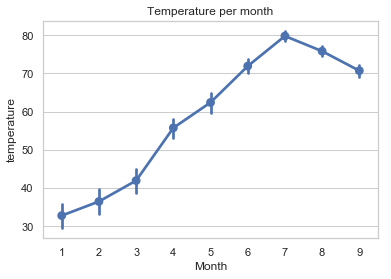

In [23]:
select = boro_precinct_arrest.groupby(["MONTH","DAY"]).Temperature.mean().reset_index()
sns.pointplot(select["MONTH"],select["Temperature"])
plt.xlabel("Month")
plt.ylabel("temperature") 
plt.title("Temperature per month");

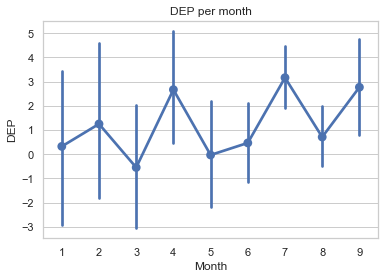

In [24]:
select = boro_precinct_arrest.groupby(["MONTH","DAY"]).DEP.mean().reset_index()
sns.pointplot(select["MONTH"],select["DEP"])
plt.xlabel("Month")
plt.ylabel("DEP") 
plt.title("DEP per month");

In [25]:
boro_precinct_arrest.groupby(["SEASON","LAW_CAT_CD"]).size()

SEASON  LAW_CAT_CD
Autumn  F              6657
        I                28
        M              9560
        V               207
Spring  F             22094
        I               134
        M             34887
        V               777
Summer  F             21538
        I               102
        M             32077
        V               828
Winter  F             13858
        I                90
        M             22995
        V               494
dtype: int64

In [26]:
feature_importance = pd.DataFrame()
for season in boro_precinct_arrest.SEASON.unique():
    select = boro_precinct_arrest[boro_precinct_arrest.SEASON == season].copy()
    select.dropna(inplace = True)
    y = select["LAW_CAT_CD"].copy()
    x = select[["WEEKDAY","DAY","MONTH","DEP","Temperature"]].copy()

    for c in ["WEEKDAY","DAY","MONTH"]:
        temp = pd.get_dummies(x[c], prefix =c, drop_first = False).astype("object")
        x.drop(columns = c, inplace = True)
        x = pd.concat([x, temp], axis =1,sort=False)
    rfc = RandomForestClassifier(n_estimators = 10)
    rfc.fit(x,y)
    feature_importance = pd.concat([feature_importance,pd.DataFrame(rfc.feature_importances_, index = x.columns, columns =[season])], axis = 1,sort=False)

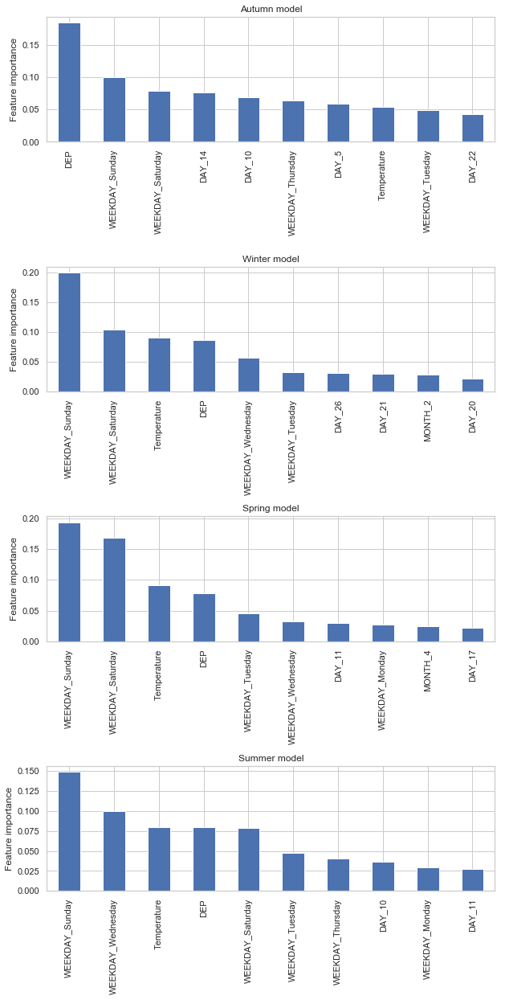

In [27]:
plt.figure(figsize = (10,20))
plt.subplot(4,1,1)
feature_importance.Autumn.sort_values(ascending = False).iloc[:10].plot.bar();
plt.ylabel("Feature importance")
plt.title("Autumn model")
plt.subplot(4,1,2)
feature_importance.Winter.sort_values(ascending = False).iloc[:10].plot.bar();
plt.ylabel("Feature importance")
plt.title("Winter model")
plt.subplot(4,1,3)
feature_importance.Spring.sort_values(ascending = False).iloc[:10].plot.bar();
plt.ylabel("Feature importance")
plt.title("Spring model")
plt.subplot(4,1,4)
feature_importance.Summer.sort_values(ascending = False).iloc[:10].plot.bar();
plt.ylabel("Feature importance")
plt.title("Summer model")
plt.subplots_adjust(wspace=1, hspace =1)

### Exploring correlation with the number of arrests

In [1]:
@interact
def barplot_sex(borough = list(districts.Borough.unique())+["NYC"]):
    if borough!="NYC":
        select = districts[districts.Borough == borough]
        fig, ax = plt.subplots()
        ax.barh( select["boro_cd"].astype("str"),select["Arr_SF"], facecolor='lightpink', edgecolor=None, label = "Female")
        ax.barh( select["boro_cd"].astype("str"),-select["Arr_SM"], facecolor='lightblue', edgecolor=None, label = "Male")
        for x, y in zip(select["boro_cd"].astype("str"),select["Arr_SF"]):
            ax.text(y+0.4, x,  '%.2f' % y, ha='center', va= 'center')
        for x, y in zip(select["boro_cd"].astype("str"),select["Arr_SM"]):
            ax.text(-y-0.4, x,  '%.2f' % y, ha='center', va= 'center')
     
        ax.axes.get_xaxis().set_visible(False)
        ax.set_frame_on(False)
        plt.ylabel("boro cd")
        plt.xlim((-select.Arr_SM.max()-0.8,select.Arr_SF.max()+0.8))
        plt.title("Arrests per 100 inhabitants in "+borough)
        plt.legend(title = "Sex", bbox_to_anchor=(1.2, 1))
        plt.show()
    else:
        select = districts.groupby(["Borough"])[["Arr_SF","Arr_SM"]].mean()
        fig, ax = plt.subplots()
        ax.barh( select.index,select["Arr_SF"], facecolor='lightpink', edgecolor=None, label = "Female")
        ax.barh( select.index,-select["Arr_SM"], facecolor='lightblue', edgecolor=None, label = "Male")
        for x, y in zip(select.index,select["Arr_SF"]):
            ax.text(y+0.4, x,  '%.2f' % y, ha='center', va= 'center')
        for x, y in zip(select.index,select["Arr_SM"]):
            ax.text(-y-0.4, x,  '%.2f' % y, ha='center', va= 'center')
     
        ax.axes.get_xaxis().set_visible(False)
        ax.set_frame_on(False)
        plt.ylabel("Borough")
        plt.xlim((-select.Arr_SM.max()-0.8,select.Arr_SF.max()+0.8))
        plt.title("Arrests per 100 habitants in NYC")
        plt.legend(title = "Sex", bbox_to_anchor=(1.2, 1))
        plt.show()


NameError: name 'interact' is not defined

In [29]:
@interact
def barplot_typeofarrest(borough = list(districts.Borough.unique())+["NYC"]):
    select = districts
    if borough!="NYC":
        select = districts[districts.Borough == borough]
        
    plt.figure(figsize =(10,10))
    ax = plt.axes(projection='3d')

    cmap = plt.cm.coolwarm

        
    selectM = select[["Arr_CF//SM","Arr_CI//SM","Arr_CM//SM","Arr_CV//SM"]].apply("mean")
    selectF = select[["Arr_CF//SF","Arr_CI//SF","Arr_CM//SF","Arr_CV//SF"]].apply("mean")


    ax.bar3d([0,1,2,3],
                 0,
                 0,0.4,0.4,
                 selectM.values,
                 color = list(map(cmap,selectM.rank().values/selectM.shape[0])))

    ax.bar3d([0,1,2,3],
                 1,
                 0,0.4,0.4,
                 selectF.values,
                 color = list(map(cmap,selectF.rank().values/selectF.shape[0])))

    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))


    plt.xlabel("Type of arrest")
    plt.ylabel("Sex")
    plt.yticks([0,1], labels = ["M","F"])
    plt.xticks([0,1,2,3], labels = ["F","I","M","V"])
    ax.set_zlabel("Arrests per 100 inhabitants")
    plt.title("Type of arrests in "+borough);
        

interactive(children=(Dropdown(description='borough', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'St…

In [30]:
@interact
def barplot_typeofarrest(borough = list(districts.Borough.unique())+["NYC"]):
    select = districts
    if borough!="NYC":
        select = districts[districts.Borough == borough]
        
    plt.figure(figsize =(10,10))
    ax = plt.axes(projection='3d')

    cmap = plt.cm.coolwarm

        
    select = select[[col for col in districts.columns if "Arr_CF//R" in col]+[col for col in districts.columns if "Arr_CI//R" in col]+[col for col in districts.columns if "Arr_CM//R" in col]+[col for col in districts.columns if "Arr_CV//R" in col]].apply("mean")


    ax.bar3d([0,1,2,3,4,5,6],
                 0,
                 0,0.4,0.4,
                 select.loc[[col for col in select.index if "Arr_CV" in col]].values,
                 color = list(map(cmap,select.loc[[col for col in select.index if "Arr_CV" in col]].rank().values/select.loc[[col for col in select.index if "Arr_CV" in col]].shape[0])))


    ax.bar3d([0,1,2,3,4,5,6],
                 1,
                 0,0.4,0.4,
                 select.loc[[col for col in select.index if "Arr_CI" in col]].values,
                 color = list(map(cmap,select.loc[[col for col in select.index if "Arr_CI" in col]].rank().values/select.loc[[col for col in select.index if "Arr_CI" in col]].shape[0])))


    ax.bar3d([0,1,2,3,4,5,6],
                 2,
                 0,0.4,0.4,
                 select.loc[[col for col in select.index if "Arr_CM" in col]].values,
                 color = list(map(cmap,select.loc[[col for col in select.index if "Arr_CM" in col]].rank().values/select.loc[[col for col in select.index if "Arr_CM" in col]].shape[0])))


    ax.bar3d([0,1,2,3,4,5,6],
                 3,
                 0,0.4,0.4,
                 select.loc[[col for col in select.index if "Arr_CF" in col]].values,
                 color = list(map(cmap,select.loc[[col for col in select.index if "Arr_CF" in col]].rank().values/select.loc[[col for col in select.index if "Arr_CF" in col]].shape[0])))



    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))


    plt.ylabel("Type of arrest")
    plt.yticks([0,1,2,3], labels = ["V","I","M","F"])
    plt.xticks([0,1,2,3,4,5.2,6], labels = ["BLACK HISPANIC","BLACK","WHITE","WHITE HISPANIC","ASIAN / PACIFIC ISLANDER","UNKNOWN","AMERICAN INDIAN/ALASKAN NATIVE"])
    ax.set_zlabel("Arrests per 100 inhabitants")
    plt.title("Type of arrests in "+borough);
        

interactive(children=(Dropdown(description='borough', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'St…

In [31]:
@interact
def barplotAge(borough = list(districts.Borough.unique())+["NYC"]):
    select = districts
    if borough!="NYC":
        select = districts[districts.Borough == borough]
        
    plt.figure(figsize =(10,10))
    ax = plt.axes(projection='3d')

    cmap = plt.cm.coolwarm

        
    selectM = select[["Arr_A<18//SM","Arr_A18-24//SM","Arr_A25-44//SM","Arr_A45-64//SM","Arr_A65+//SM"]].apply("mean")
    selectF = select[["Arr_A<18//SF","Arr_A18-24//SF","Arr_A25-44//SF","Arr_A45-64//SF","Arr_A65+//SF"]].apply("mean")


    ax.bar3d([0,1,2,3,4],
                 0,
                 0,0.4,0.4,
                 selectM.values,
                 color = list(map(cmap,selectM.rank().values/selectM.shape[0])))

    ax.bar3d([0,1,2,3,4],
                 1,
                 0,0.4,0.4,
                 selectF.values,
                 color = list(map(cmap,selectF.rank().values/selectF.shape[0])))

    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))


    plt.xlabel("Age")
    plt.ylabel("Sex")
    plt.yticks([0,1], labels = ["M","F"])
    plt.xticks([0,1,2,3,4], labels = ["<18","18-24","25-44","45-64","65+"])
    ax.set_zlabel("Arrests per 100 inhabitants")
    plt.title("Age of arrests in "+borough);
        

interactive(children=(Dropdown(description='borough', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'St…

### Exploring spatial variation and correlation

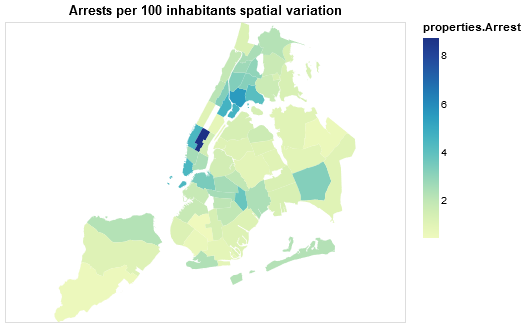

In [32]:
alt.Chart(alt.InlineData(values = districts.to_json(),
                       format = alt.DataFormat(property='features',type='json')
                        ) ).mark_geoshape().encode(color = "properties.Arrest:Q",
                                                   tooltip=['properties.Borough:N','properties.boro_cd:N',"properties.Arrest:Q"]
).properties(
    title='Arrests per 100 inhabitants spatial variation'
)

In [33]:
@interact
def Arrests_Schools( boro =  districts.Borough.unique()):
    select = districts.Borough == boro
    districts[select].plot(column = "Arrest", figsize=(10,5), cmap="Blues", edgecolor='black', legend = True, 
                             legend_kwds={'label': 'Arrests'} )
    
        
    temp = schools[schools.boro_name == boro]
    sns.kdeplot(temp["Longitude"], temp["Latitude"], cmap = "OrRd", cbar = True, cbar_kws={'label': 'Schools'} ) 
    
    plt.title( "Arrests in "+boro )
    plt.axis("off")
    plt.show( );

interactive(children=(Dropdown(description='boro', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'State…

In [34]:
@interact
def Arrest_School_3D(borough = districts.Borough.unique(), type_of_schools = [col for col in districts.columns if "Schools/Tot" in col]):
    cmap = plt.cm.Blues
    select = districts[districts.Borough == borough]
    centroids = np.array([[c.x,c.y] for c in select.geometry.centroid])
    
    fig = plt.figure(figsize = (15,8))
    ax = plt.axes(projection='3d')
    
    for i in range(len(centroids)):
        ax.bar3d(centroids[i,0], centroids[i,1], 0, 0.002, 0.002, select[type_of_schools].iloc[i], color = plt.cm.OrRd(select[type_of_schools].rank().iloc[i]/select[type_of_schools].shape[0]))
    blue = plt.Rectangle((0, 0), 1, 1, fc="red")
    ax.legend([blue],[type_of_schools],  bbox_to_anchor=(0.5, 0., 0.65, 1), title = "Schools")
    

    colors = []
    l = []
    xmax = -80
    xmin = -60
    ymax = 40
    ymin = 45
    for i in range(select.shape[0]): 
        if select['geometry'].iloc[i].geom_type=='Polygon':
            c1 = np.array(select['geometry'].iloc[i].exterior)
            l.append(list(zip(c1[:,0],c1[:,1])))
            colors.append(cmap((select.Arrest.rank()/len(select.Arrest)).iloc[i]))
            if xmax<c1[:,0].max():
                xmax = c1[:,0].max()
            if xmin>c1[:,0].min():
                xmin = c1[:,0].min()
            if ymax<c1[:,1].max():
                ymax = c1[:,1].max()
            if ymin>c1[:,1].min():
                ymin = c1[:,1].min()
        else:
            for j in range(len(select['geometry'].iloc[i])):
                c1 = np.array(select['geometry'].iloc[i][j].exterior)  
                l.append(list(zip(c1[:,0],c1[:,1])))
                colors.append(cmap((select.Arrest.rank()/len(select.Arrest)).iloc[i]))
                if xmax<c1[:,0].max():
                    xmax = c1[:,0].max()
                if xmin>c1[:,0].min():
                    xmin = c1[:,0].min()
                if ymax<c1[:,1].max():
                    ymax = c1[:,1].max()
                if ymin>c1[:,1].min():
                    ymin = c1[:,1].min()
    poly = PolyCollection(l, edgecolors = "black", facecolors = colors)
    ax.add_collection3d(poly, zs=0, zdir='z')

    
    m = cm.ScalarMappable(cmap=cmap)
    m.set_array(select.Arrest)
    color_bar = plt.colorbar(m, shrink = 0.5, orientation="vertical" )
    color_bar.set_label("Arrests per 100 inhabitants")

    plt.title( borough )
    ax.set_xlim((xmin,xmax))
    ax.set_ylim((ymin,ymax))
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    plt.xticks([])
    plt.yticks([])
    ax.set_zlabel("Number of schools per 100 inhabitants")

interactive(children=(Dropdown(description='borough', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'St…

In [35]:
@interact
def Arrests_PI( boro =  districts.Borough.unique()):
    select = districts.Borough == boro
    districts[select].plot(column = "Arrest", figsize=(10,5), cmap="Blues", edgecolor='black', legend = True, 
                             legend_kwds={'label': 'Arrests'} )
    
        
    temp = boro_PI[boro_PI.BOROUGH == boro]
    sns.kdeplot(temp["Longitude"], temp["Latitude"], cmap = "OrRd", cbar = True, cbar_kws={'label': 'Points of Interest'} ) 
    
    plt.title( "Arrests in "+boro )
    plt.axis("off")
    plt.show( );

interactive(children=(Dropdown(description='boro', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'State…

In [36]:
@interact
def Arrest_PI_3D(borough = districts.Borough.unique(), type_of_PI = [col for col in districts.columns if "PI/Tot" in col]):
    cmap = plt.cm.Blues
    select = districts[districts.Borough == borough]
    centroids = np.array([[c.x,c.y] for c in select.geometry.centroid])
    
    fig = plt.figure(figsize = (15,8))
    ax = plt.axes(projection='3d')
    
    for i in range(len(centroids)):
        ax.bar3d(centroids[i,0], centroids[i,1], 0, 0.002, 0.002, select[type_of_PI].iloc[i], color = plt.cm.OrRd(select[type_of_PI].rank().iloc[i]/select[type_of_PI].shape[0]))
    blue = plt.Rectangle((0, 0), 1, 1, fc="red")
    ax.legend([blue],[type_of_PI],  bbox_to_anchor=(0.5, 0., 0.65, 1), title = "PI")
    

    colors = []
    l = []
    xmax = -80
    xmin = -60
    ymax = 40
    ymin = 45
    for i in range(select.shape[0]): 
        if select['geometry'].iloc[i].geom_type=='Polygon':
            c1 = np.array(select['geometry'].iloc[i].exterior)
            l.append(list(zip(c1[:,0],c1[:,1])))
            colors.append(cmap((select.Arrest.rank()/len(select.Arrest)).iloc[i]))
            if xmax<c1[:,0].max():
                xmax = c1[:,0].max()
            if xmin>c1[:,0].min():
                xmin = c1[:,0].min()
            if ymax<c1[:,1].max():
                ymax = c1[:,1].max()
            if ymin>c1[:,1].min():
                ymin = c1[:,1].min()
        else:
            for j in range(len(select['geometry'].iloc[i])):
                c1 = np.array(select['geometry'].iloc[i][j].exterior)  
                l.append(list(zip(c1[:,0],c1[:,1])))
                colors.append(cmap((select.Arrest.rank()/len(select.Arrest)).iloc[i]))
                if xmax<c1[:,0].max():
                    xmax = c1[:,0].max()
                if xmin>c1[:,0].min():
                    xmin = c1[:,0].min()
                if ymax<c1[:,1].max():
                    ymax = c1[:,1].max()
                if ymin>c1[:,1].min():
                    ymin = c1[:,1].min()
    poly = PolyCollection(l, edgecolors = "black", facecolors = colors)
    ax.add_collection3d(poly, zs=0, zdir='z')

    
    m = cm.ScalarMappable(cmap=cmap)
    m.set_array(select.Arrest)
    color_bar = plt.colorbar(m, shrink = 0.5, orientation="vertical" )
    color_bar.set_label("Arrests per 100 inhabitants")

    plt.title( borough )
    ax.set_xlim((xmin,xmax))
    ax.set_ylim((ymin,ymax))
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    plt.xticks([])
    plt.yticks([])
    ax.set_zlabel("Number of PI per 100 inhabitants")

interactive(children=(Dropdown(description='borough', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'St…

In [37]:
@interact
def Arrest_multichoice_3D(borough = districts.Borough.unique(),
                          crime = ["F","I","M","V","all"],
                          age = ["25-44","18-24","45-64","<18","65+","all"],
                          ethnicity = ['BLACK HISPANIC', 'BLACK', 'WHITE', 'WHITE HISPANIC',
                                  'ASIAN / PACIFIC ISLANDER', 'UNKNOWN',
                                  'AMERICAN INDIAN/ALASKAN NATIVE', "all"],
                          map_column = [col for col in districts if "demo" in col]+["Population_2019"]):
    cmap = plt.cm.YlGn
    select = districts[districts.Borough == borough]
    centroids = np.array([[c.x,c.y] for c in select.geometry.centroid])
    
    fig = plt.figure(figsize = (15,8))
    ax = plt.axes(projection='3d')
    
    name = "Arr_"
    if age!="all":
        name = name + "A"+age 
    if crime!="all":
        if name[-1]!="_":
            name =  name + "//C"+crime
        else:
            name =  name + "C"+crime
    if ethnicity!="all":
        if name[-1]!="_":
            name =  name + "//R"+ethnicity
        else:
            name =  name + "R"+ethnicity
    if name[-1]!="_":
        name = name + "//"
        
        
    for i in range(len(centroids)):
        ax.bar3d(centroids[i,0], centroids[i,1], 0, 0.002, 0.002, select[name + "SM"].iloc[i], color = plt.cm.Blues(select[name+"SM"].rank().iloc[i]/select[name+"SM"].shape[0]))
        ax.bar3d(centroids[i,0]+0.002, centroids[i,1]+0.002, 0, 0.002, 0.002, select[name+"SF"].iloc[i], color = plt.cm.RdPu(select[name+"SF"].rank().iloc[i]/select[name+"SF"].shape[0]))
    blue = plt.Rectangle((0, 0), 1, 1, fc="blue")
    pink = plt.Rectangle((0, 0), 1, 1, fc="purple")
    ax.legend([blue,pink],[name+"SM",name+"SF"],  bbox_to_anchor=(0.5, 0., 0.65, 1), title = "Sex")

    colors = []
    l = []
    xmax = -80
    xmin = -60
    ymax = 40
    ymin = 45
    for i in range(select.shape[0]): 
        if select['geometry'].iloc[i].geom_type=='Polygon':
            c1 = np.array(select['geometry'].iloc[i].exterior)
            l.append(list(zip(c1[:,0],c1[:,1])))
            colors.append(cmap((select[map_column].rank()/len(select[map_column])).iloc[i]))
            if xmax<c1[:,0].max():
                xmax = c1[:,0].max()
            if xmin>c1[:,0].min():
                xmin = c1[:,0].min()
            if ymax<c1[:,1].max():
                ymax = c1[:,1].max()
            if ymin>c1[:,1].min():
                ymin = c1[:,1].min()
        else:
            for j in range(len(select['geometry'].iloc[i])):
                c1 = np.array(select['geometry'].iloc[i][j].exterior)  
                l.append(list(zip(c1[:,0],c1[:,1])))
                colors.append(cmap((select[map_column].rank()/len(select[map_column])).iloc[i]))
                if xmax<c1[:,0].max():
                    xmax = c1[:,0].max()
                if xmin>c1[:,0].min():
                    xmin = c1[:,0].min()
                if ymax<c1[:,1].max():
                    ymax = c1[:,1].max()
                if ymin>c1[:,1].min():
                    ymin = c1[:,1].min()
    poly = PolyCollection(l, edgecolors = "black", facecolors = colors)
    ax.add_collection3d(poly, zs=0, zdir='z')

    
    m = cm.ScalarMappable(cmap=cmap)
    m.set_array(select.Arrest)
    color_bar = plt.colorbar(m, shrink = 0.5, orientation="vertical" )
    color_bar.set_label(map_column)

    plt.title( borough )
    ax.set_xlim((xmin,xmax))
    ax.set_ylim((ymin,ymax))
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    plt.xticks([])
    plt.yticks([])
    ax.set_zlabel("Number of Arrests per 100 inhabitants")

interactive(children=(Dropdown(description='borough', options=('Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'St…

### Model spatial correlation

In [38]:
arr_column = "Arrest"

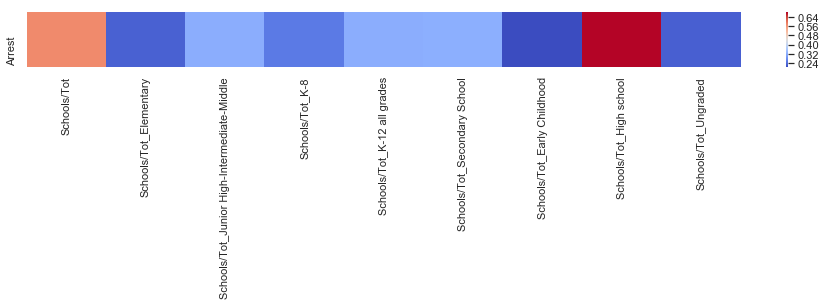

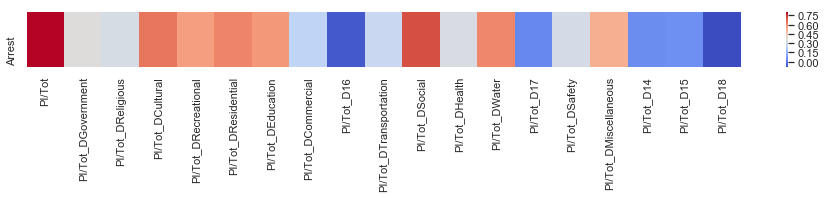

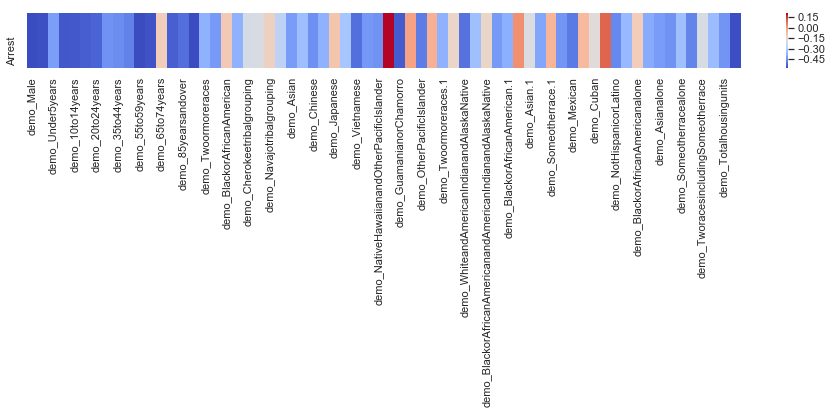

In [39]:
correlation_arrest_col(districts, arr_column= "Arrest")

In [40]:
variables_to_compare =  [col for col in districts.columns if "PI" in col] + [col for col in districts.columns if "Schools" in col]+[col for col in districts if "demo" in col] 

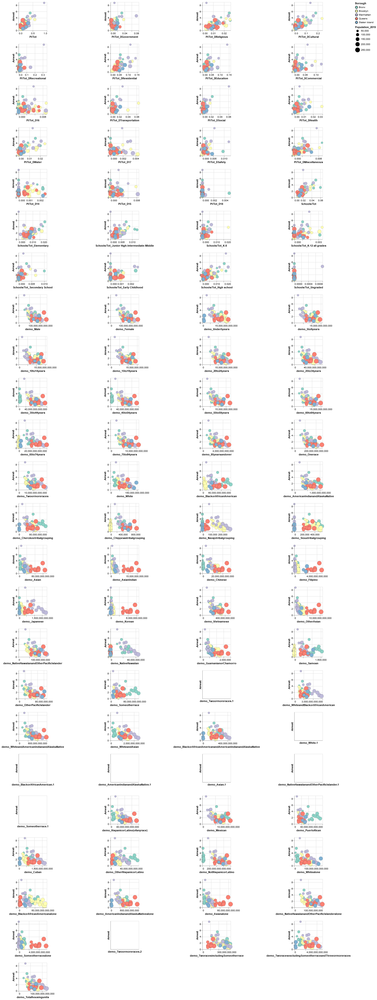

In [41]:
input_dropdown = alt.binding_select(options=districts.Borough.unique().tolist())
selection = alt.selection_single(fields=['Borough'], bind=input_dropdown, name='Select')
opacity = alt.condition(selection,alt.value(1),alt.value(0.2)) 

alt.Chart(districts[["Population_2019", arr_column,"boro_cd","Borough"]+variables_to_compare]).mark_circle(strokeWidth=1,stroke='black',strokeOpacity=0.2).encode(
    x=alt.X(alt.repeat(), type='quantitative'),
    y=alt.Y(arr_column+':Q'),
    size='Population_2019:Q',
    color=alt.Color('Borough:N', scale=alt.Scale(scheme='set3')), 
    opacity=opacity,
    tooltip=['boro_cd:N','Borough:N', arr_column+':Q']
).properties(
    width=120,
    height=120
).add_selection(
    selection
).repeat(variables_to_compare,
    columns=4
).resolve_scale(x='independent',y='independent'
)

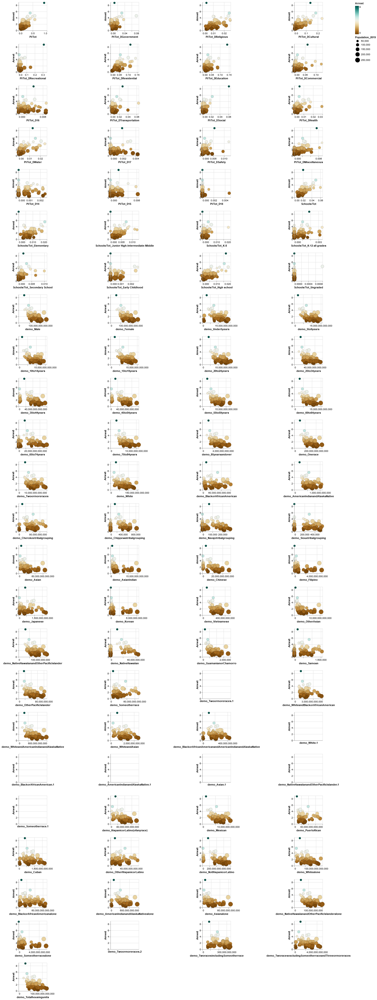

In [42]:
input_dropdown = alt.binding_select(options=districts.Borough.unique().tolist())
selection = alt.selection_single(fields=['Borough'], bind=input_dropdown, name='Select')
opacity = alt.condition(selection,alt.value(1),alt.value(0))

alt.Chart(districts[["Population_2019", arr_column,"boro_cd","Borough"]+variables_to_compare]).mark_circle(strokeWidth=1,stroke='black',strokeOpacity=0.2).encode(
    x=alt.X(alt.repeat(), type='quantitative'),
    y=alt.Y(arr_column+':Q'),
    size='Population_2019:Q',
    color=alt.Color(arr_column+':Q', scale=alt.Scale(scheme='brownbluegreen')),
    opacity=opacity,
    tooltip=['boro_cd:N','Borough:N', arr_column+':Q']
).properties(
    width=120,
    height=120
).add_selection(
    selection
).repeat(variables_to_compare,
    columns=4
).resolve_scale(x='independent',y='shared'
)

#### Assumptions of linear regression and the case for local model

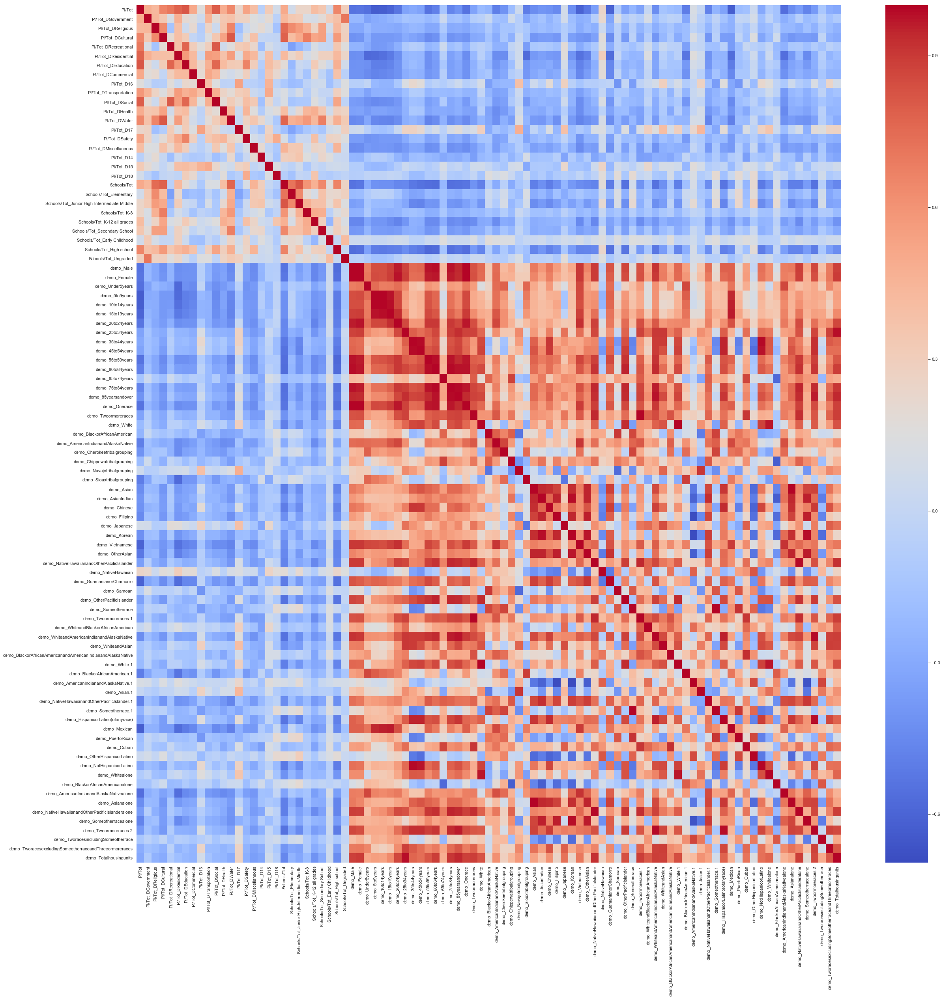

In [43]:
plt.figure(figsize = (40,40))
sns.heatmap(districts[variables_to_compare].corr(), cmap = "coolwarm");

In [44]:
model_variables = ["PI/Tot", "Schools/Tot", "Population_2019"]
lm1 = sm.OLS(districts[arr_column], districts[model_variables]).fit()
print(lm1.summary())

                                 OLS Regression Results                                
Dep. Variable:                 Arrest   R-squared (uncentered):                   0.908
Model:                            OLS   Adj. R-squared (uncentered):              0.903
Method:                 Least Squares   F-statistic:                              183.9
Date:                Thu, 12 Dec 2019   Prob (F-statistic):                    5.86e-29
Time:                        10:08:25   Log-Likelihood:                         -69.857
No. Observations:                  59   AIC:                                      145.7
Df Residuals:                      56   BIC:                                      151.9
Df Model:                           3                                                  
Covariance Type:            nonrobust                                                  
                      coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------

In [45]:
variables = lm1.model.exog
vif = [variance_inflation_factor(variables, i) for i in range(variables.shape[1])]
for i in range(len(model_variables)):
    display(Markdown('**'+model_variables[i]+'**:' + str(vif[i])))

**PI/Tot**:4.454642242737373

**Schools/Tot**:5.27477010344144

**Population_2019**:2.5895021105165217

In [46]:
model_variables = [col for col in districts.columns if "PI" in col and col!="PI/Tot"] + [col for col in districts.columns if "Schools" in col and col!="Schools/Tot"]
lm2 = sm.OLS(districts[arr_column], districts[model_variables]).fit()
print(lm2.summary())

                                 OLS Regression Results                                
Dep. Variable:                 Arrest   R-squared (uncentered):                   0.958
Model:                            OLS   Adj. R-squared (uncentered):              0.925
Method:                 Least Squares   F-statistic:                              29.02
Date:                Thu, 12 Dec 2019   Prob (F-statistic):                    4.55e-16
Time:                        10:08:25   Log-Likelihood:                         -46.609
No. Observations:                  59   AIC:                                      145.2
Df Residuals:                      33   BIC:                                      199.2
Df Model:                          26                                                  
Covariance Type:            nonrobust                                                  
                                                  coef    std err          t      P>|t|      [0.025      0.975]
--------

In [47]:
variables = lm2.model.exog
vif = [variance_inflation_factor(variables, i) for i in range(variables.shape[1])]
for i in range(len(model_variables)):
    display(Markdown('**'+model_variables[i]+'**:' + str(vif[i])))

**PI/Tot_DGovernment**:11.355767955963854

**PI/Tot_DReligious**:31.195303948546105

**PI/Tot_DCultural**:35.70940391511341

**PI/Tot_DRecreational**:20.289642042520207

**PI/Tot_DResidential**:20.2104454531649

**PI/Tot_DEducation**:63.92556736115802

**PI/Tot_DCommercial**:6.099731616267166

**PI/Tot_D16**:6.36079776494201

**PI/Tot_DTransportation**:5.701993380732409

**PI/Tot_DSocial**:12.933818952804415

**PI/Tot_DHealth**:9.48071152229551

**PI/Tot_DWater**:16.04939593147311

**PI/Tot_D17**:3.7304097735041872

**PI/Tot_DSafety**:8.380644543123186

**PI/Tot_DMiscellaneous**:5.65779565869812

**PI/Tot_D14**:3.068317467186519

**PI/Tot_D15**:4.941197194580347

**PI/Tot_D18**:4.090750404309509

**Schools/Tot_Elementary**:20.93740720243241

**Schools/Tot_Junior High-Intermediate-Middle**:12.99304603866475

**Schools/Tot_K-8**:6.816721758991031

**Schools/Tot_K-12 all grades**:6.046663528612

**Schools/Tot_Secondary School**:4.4964267614480615

**Schools/Tot_Early Childhood**:3.433171183959596

**Schools/Tot_High school**:11.130015938337149

**Schools/Tot_Ungraded**:4.991606468188488

####  Exposing regional variation

In [48]:
districts["resids1"] = lm1.resid
districts["resids2"] = lm2.resid

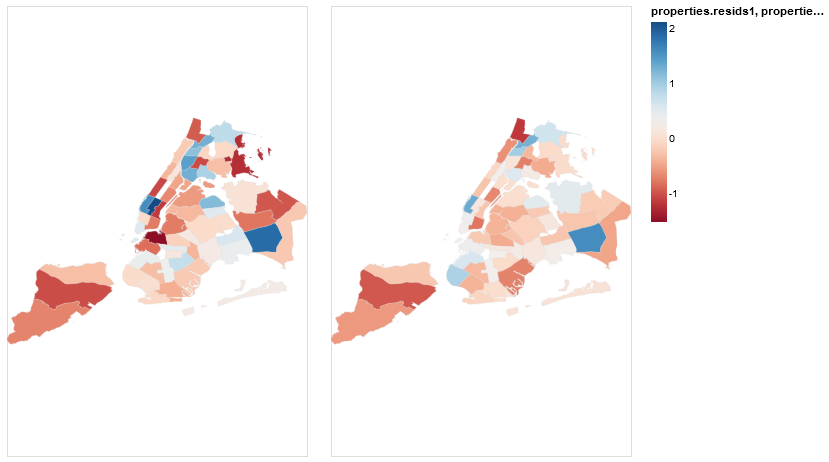

In [49]:
alt.Chart(alt.InlineData(values = districts.to_json(),
                       format = alt.DataFormat(property='features',type='json')) ).mark_geoshape(strokeWidth=1,stroke='lightgray',strokeOpacity=0.2
).encode(color=alt.Color(alt.repeat('column'), type='quantitative', scale=alt.Scale(scheme='redblue')),
    tooltip=['properties.Borough:N','properties.boro_cd:N',alt.Tooltip(alt.repeat("column"), type="quantitative")]
).properties(
    projection={'type': 'identity','reflectY': True},
    width=300,
    height=450
).repeat(column=['properties.resids1','properties.resids2'])

#### Exploring spatially-varying relationships using geographically-weighted statistics

In [68]:
#GWR below requires the "centroids" of each geographical area
centroids = np.array([[c.x,c.y] for c in districts.geometry.centroid])

#These are all the variables we want to apply geographically-weighted statistics
refined_vars = model_variables
coeff_names = ['intercept']
map_vars = []
for var in refined_vars:
    coeff_names.append('coeff_'+var)
    map_vars.append('properties.coeff_'+var)

In [69]:
#Define GWR model
model = GWR(centroids,districts[arr_column].to_numpy().reshape((-1,1))
            ,districts[refined_vars].to_numpy(),bw=50,kernel='bisquare',fixed=False)
gw_results = model.fit()

In [70]:
corr_matrix = all_corr(gw_results,refined_vars+[arr_column])
#Filter only those correlation coefficients against Arrest
corr_2 = [{d['var']: d['value'] for d in x if d['var_2'] == arr_column} for x in corr_matrix]
corr_coeffs = pd.DataFrame.from_records(corr_2)

In [71]:
#Check if we have what we wanted (all variables correlated with Arrest)
corr_coeffs.head()

,PI/Tot_D14_Arrest,PI/Tot_D15_Arrest,PI/Tot_D16_Arrest,PI/Tot_D17_Arrest,PI/Tot_D18_Arrest,PI/Tot_DCommercial_Arrest,PI/Tot_DCultural_Arrest,PI/Tot_DEducation_Arrest,PI/Tot_DGovernment_Arrest,PI/Tot_DHealth_Arrest,...,PI/Tot_DTransportation_Arrest,PI/Tot_DWater_Arrest,Schools/Tot_Early Childhood_Arrest,Schools/Tot_Elementary_Arrest,Schools/Tot_High school_Arrest,Schools/Tot_Junior High-Intermediate-Middle_Arrest,Schools/Tot_K-12 all grades_Arrest,Schools/Tot_K-8_Arrest,Schools/Tot_Secondary School_Arrest,Schools/Tot_Ungraded_Arrest
0,0.065947,-0.128922,0.014164,0.078716,-0.133733,0.192154,0.678316,0.514915,0.411816,0.428174,...,0.449931,0.640789,0.151329,0.363306,0.623372,0.279468,0.397598,0.308110,0.317223,0.265732
1,0.121885,-0.163761,-0.025428,0.060139,-0.142537,0.163993,0.693936,0.451538,0.438651,0.411061,...,0.439918,0.667432,0.168745,0.456517,0.612379,0.359644,0.339033,0.374039,0.348830,0.282916
2,0.110875,-0.167817,-0.017356,0.068391,-0.148729,0.154845,0.685204,0.453698,0.432709,0.403809,...,0.440499,0.659795,0.177908,0.433406,0.600914,0.327420,0.348322,0.357977,0.331775,0.277106
3,0.076234,-0.143610,0.005773,0.084425,-0.142511,0.172441,0.672984,0.496724,0.413355,0.414596,...,0.444258,0.640532,0.167651,0.365372,0.608001,0.272328,0.383677,0.307378,0.308447,0.264298
4,0.102009,-0.162977,-0.012446,0.081933,-0.150873,0.152620,0.675272,0.462609,0.424481,0.400361,...,0.436243,0.650356,0.183443,0.400772,0.595247,0.299068,0.351084,0.333244,0.316057,0.269794


In [72]:
corr_df = pd.merge(districts,corr_coeffs,left_index=True,right_index=True)
map_vars = ['properties.'+v for v in corr_coeffs.columns.values ]
corr_geo = alt.InlineData(values = corr_df.to_json(),
                       format = alt.DataFormat(property='features',type='json'))

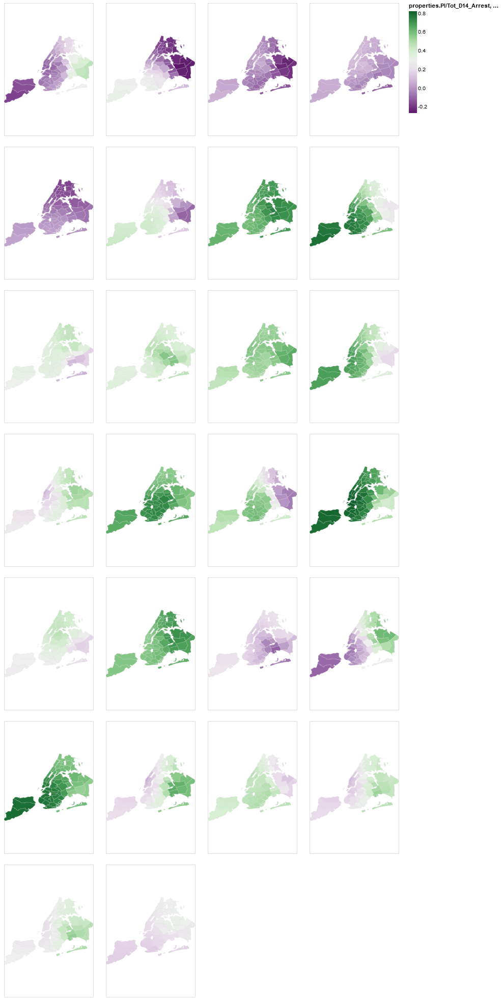

In [73]:
alt.Chart(corr_geo 
).mark_geoshape(strokeWidth=1,stroke='lightgray',strokeOpacity=0.2
).encode(color=alt.Color(alt.repeat('repeat'), type='quantitative', scale=alt.Scale(scheme='purplegreen')),
    tooltip=['properties.Borough:N','properties.boro_cd:N',alt.Tooltip(alt.repeat("repeat"), type="quantitative")]
).properties(
    projection={'type': 'identity','reflectY': True},
    width=175,
    height=260,
).repeat(map_vars,columns=4)

> Clusters

In [74]:
#First we standardise the variables

scaler = StandardScaler()
scaled_coefficients=scaler.fit_transform(corr_coeffs)
scaled_df = pd.DataFrame(scaled_coefficients,columns=corr_coeffs.columns)

In [75]:
cluster_results = [None]*20
for i in range(2,20): 
    ac =  AgglomerativeClustering(linkage='ward', n_clusters=i)
    cr = ac.fit(scaled_df.values)
    cluster_results[i] = cr
    print(str(i)+" clusters. Avg silhouette score:",silhouette_score(scaled_df.values,cr.labels_))

2 clusters. Avg silhouette score: 0.4288990537608591
3 clusters. Avg silhouette score: 0.40656767188209236
4 clusters. Avg silhouette score: 0.4351005411267774
5 clusters. Avg silhouette score: 0.37953810397878524
6 clusters. Avg silhouette score: 0.39738138453295163
7 clusters. Avg silhouette score: 0.3591821972253358
8 clusters. Avg silhouette score: 0.3746408583783205
9 clusters. Avg silhouette score: 0.3879670834446969
10 clusters. Avg silhouette score: 0.38633023620369084
11 clusters. Avg silhouette score: 0.37971391868974885
12 clusters. Avg silhouette score: 0.35514579763682613
13 clusters. Avg silhouette score: 0.3473845905752566
14 clusters. Avg silhouette score: 0.35065880589438253
15 clusters. Avg silhouette score: 0.3420909935521305
16 clusters. Avg silhouette score: 0.35281487365448966
17 clusters. Avg silhouette score: 0.34993871424256223
18 clusters. Avg silhouette score: 0.3389430570843925
19 clusters. Avg silhouette score: 0.336310440460517


In [81]:
hc_result =  cluster_results[4] 
corr_df['cluster_membership'] = hc_result.labels_
corr_coeffs['cluster_membership'] = hc_result.labels_

In [82]:
sil_scores = pd.DataFrame(
    np.column_stack((silhouette_samples(scaled_df.values,hc_result.labels_),hc_result.labels_))
    ,columns=['silhouette','cluster_m']).reset_index()

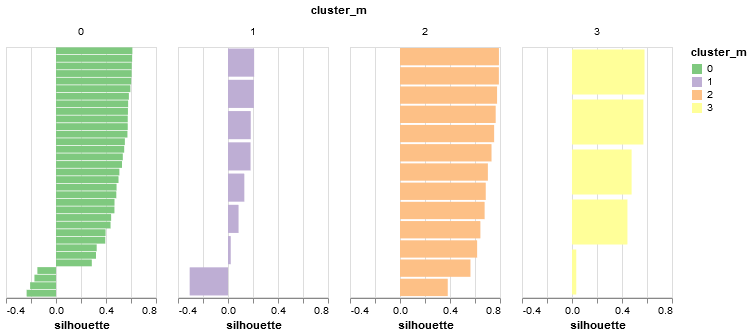

In [83]:
alt.Chart(sil_scores).mark_bar(
        ).encode(
            x='silhouette:Q',
            y=alt.Y('index:O',sort=alt.SortField(field="silhouette", order='descending'),axis=None),
            color=alt.Color('cluster_m:N',scale=alt.Scale(scheme='accent')),
            facet='cluster_m:N'
        ).properties(width=150,height=250).resolve_scale(y='independent')

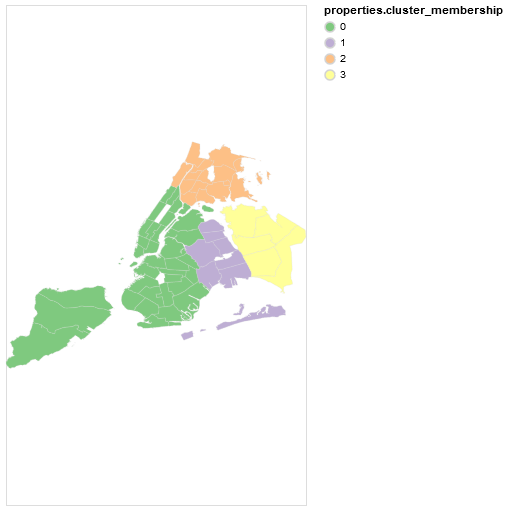

In [84]:
alt.Chart(alt.InlineData(values = corr_df.to_json(),
                       format = alt.DataFormat(property='features',type='json')) 
         ).mark_geoshape(strokeWidth=1,stroke='lightgray',strokeOpacity=0.2
        ).encode(
            color=alt.Color('properties.cluster_membership:N',scale=alt.Scale(scheme='accent')),
            tooltip=['properties.Borough:N','properties.boro_cd:N','properties.cluster_membership:N']
        ).properties(
            projection={'type': 'identity','reflectY': True},
            width=300,
            height=500,
        )

In [88]:
@interact
def coeffs_cluster_membership(correlation = corr_coeffs.drop(columns = "cluster_membership").columns):
    for i in [0,1,2,3]:
        sns.distplot( corr_coeffs[corr_coeffs.cluster_membership ==i][correlation], hist=False, color = {0:"green",1:"purple",2:"orange",3:"yellow"}[i])
    plt.ylabel("Correlation")

interactive(children=(Dropdown(description='correlation', options=('PI/Tot_D14_Arrest', 'PI/Tot_D15_Arrest', '…

    Bronx rap and hip hop culture, the site of Yankee Stadium, and home to the largest cooperatively owned housing complex in the United States, Co-op City.
    
    Brooklyn most populous borough 
    
    Manhattan most densely populated borough and home to most of the city's skyscrapers. The 
    
    Queens largest borough and the most ethnically diverse county in the United States.  residential and middle class, with enclaves of above average income and wealth. It is the only large county in the United States where the median income among African-American households, about $52,000 a year, has surpassed that of Caucasian households.  the site of Citi Field, the home of the New York Mets, and annually hosts the US Tennis Open.
    
    Staten Island Staten Island Ferry Freshkills Park, one of the largest urban parks in the United States.